In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!ls

drive  person_identification_window_index.csv  sample_data


In [ ]:
from glob2 import glob

vhdr_file_list = glob("/content/drive/MyDrive/EEG Dataset/*.vhdr")
len(vhdr_file_list)

3

In [ ]:
import numpy as np
# extract subject IDs from the file path, create python set to extract unique elements from list, convert to list again 
unique_patient_ids = list(set([x.split("/")[-1].split(".")[0] for x in vhdr_file_list]))
unique_patient_ids

['sub-010003', 'sub-010002', 'sub-010004']

In [ ]:
with open('/content/drive/MyDrive/eeg_subjects.txt', 'w') as file_handler:
    for item in unique_patient_ids:
        file_handler.write("{}\n".format(item))

In [ ]:
vhdr_file_list = glob("/content/drive/MyDrive/EEG Dataset/*.vhdr")
channel_configs = [x.split("/")[5].split(".")[0] for x in vhdr_file_list]
list(set(channel_configs))

['sub-010003', 'sub-010002', 'sub-010004']

In [ ]:
!pip install mne

In [ ]:
import mne
file_path = r'/content/drive/MyDrive/EEG Dataset/sub-010002.vhdr'
raw_data = mne.io.read_raw_brainvision(file_path, verbose=False, preload=False)
raw_data.info["ch_names"]

['Fp1',
 'Fp2',
 'F7',
 'F3',
 'Fz',
 'F4',
 'F8',
 'FC5',
 'FC1',
 'FC2',
 'FC6',
 'T7',
 'C3',
 'Cz',
 'C4',
 'T8',
 'VEOG',
 'CP5',
 'CP1',
 'CP2',
 'CP6',
 'AFz',
 'P7',
 'P3',
 'Pz',
 'P4',
 'P8',
 'PO9',
 'O1',
 'Oz',
 'O2',
 'PO10',
 'AF7',
 'AF3',
 'AF4',
 'AF8',
 'F5',
 'F1',
 'F2',
 'F6',
 'FT7',
 'FC3',
 'FC4',
 'FT8',
 'C5',
 'C1',
 'C2',
 'C6',
 'TP7',
 'CP3',
 'CPz',
 'CP4',
 'TP8',
 'P5',
 'P1',
 'P2',
 'P6',
 'PO7',
 'PO3',
 'POz',
 'PO4',
 'PO8']

In [ ]:
f = open('/content/drive/MyDrive/eeg_subjects.txt', 'r')
unique_patient_ids = f.readlines()
unique_patient_ids = [x.strip() for x in unique_patient_ids]

# pick your desired preprocessing configuration.
SAMPLING_FREQ = 250.0
WINDOW_LENGTH_SECONDS = 1.0
WINDOW_LENGTH_SAMPLES = int(WINDOW_LENGTH_SECONDS * SAMPLING_FREQ)


# loop over one subject at a time, and add corresponding metadata to csv
dataset_index_rows = [ ]
subjects=list(set(channel_configs))
label_count = {}
label=1
for sub in subjects:
  label_count[sub]=label
  label=0
for idx, patient_id in enumerate(unique_patient_ids):

    print(f"\n\n\n {patient_id} : {idx+1}/{len(unique_patient_ids)} \n\n\n")
    
    # find all vhdr files corresponding to this patient id
    patient_vhdr_file_list = glob(f"/content/drive/MyDrive/EEG Dataset/{patient_id}.vhdr")
    # CAUTION - later ignoring multiple recordings of a subject, taking only one.
    # get label of the recording from the file name, ensure all labels for the same subject are the same
    # NOTE - the label of the recording is copied to each of its windows
    labels = [x.split("/")[5].split(".")[0] for x in patient_vhdr_file_list]
    print (labels)
    label = labels[0]
    # CAUTION - considering only the first recording here!
    raw_file_path = patient_vhdr_file_list[0]
    raw_data = mne.io.read_raw_brainvision(raw_file_path, verbose=False, preload=False)
    
    # generate window metadata = one row of dataset_index
    for start_sample_index in range(0, int(int(raw_data.times[-1]) * SAMPLING_FREQ), WINDOW_LENGTH_SAMPLES):

        end_sample_index = start_sample_index + (WINDOW_LENGTH_SAMPLES - 1)
        
        # ensure 10 seconds are available in window and recording does not end
        if end_sample_index > raw_data.n_times:
            break

        row = {}
        row["patient_id"] = patient_id
        row["raw_file_path"] = patient_vhdr_file_list[0]
        row["record_length_seconds"] = raw_data.times[-1]
        # this is the desired SFREQ using which sample indices are derived.
        # CAUTION - this is not the original SFREQ at which the data is recorded.
        row["sampling_freq"] = SAMPLING_FREQ
        row["channel_config"] = raw_file_path.split("/")[5]
        row["start_sample_index"] = start_sample_index
        row["end_sample_index"] = end_sample_index
        row["text_label"] = label
        row["numeric_label"] = label_count[label]
        dataset_index_rows.append(row)
        
# create dataframe from rows, save to disk
import pandas as pd
df = pd.DataFrame(dataset_index_rows, columns=["patient_id", 
                                "raw_file_path",
                                "record_length_seconds", 
                                "sampling_freq",
                                 "channel_config",
                                "start_sample_index",
                                "end_sample_index",
                                "text_label",
                                "numeric_label"])
df.to_csv("person_identification_window_index.csv", index=False)




 sub-010003 : 1/3 



['sub-010003']



 sub-010002 : 2/3 



['sub-010002']



 sub-010004 : 3/3 



['sub-010004']


In [ ]:
label_count

{'sub-010002': 0, 'sub-010003': 1, 'sub-010004': 0}

In [ ]:
df

,patient_id,raw_file_path,record_length_seconds,sampling_freq,channel_config,start_sample_index,end_sample_index,text_label,numeric_label
0,sub-010003,/content/drive/MyDrive/EEG Dataset/sub-010003....,1007.9396,250.0,sub-010003.vhdr,0,249,sub-010003,1
1,sub-010003,/content/drive/MyDrive/EEG Dataset/sub-010003....,1007.9396,250.0,sub-010003.vhdr,250,499,sub-010003,1
2,sub-010003,/content/drive/MyDrive/EEG Dataset/sub-010003....,1007.9396,250.0,sub-010003.vhdr,500,749,sub-010003,1
3,sub-010003,/content/drive/MyDrive/EEG Dataset/sub-010003....,1007.9396,250.0,sub-010003.vhdr,750,999,sub-010003,1
4,sub-010003,/content/drive/MyDrive/EEG Dataset/sub-010003....,1007.9396,250.0,sub-010003.vhdr,1000,1249,sub-010003,1
...,...,...,...,...,...,...,...,...,...
3045,sub-010004,/content/drive/MyDrive/EEG Dataset/sub-010004....,1022.0396,250.0,sub-010004.vhdr,254250,254499,sub-010004,0
3046,sub-010004,/content/drive/MyDrive/EEG Dataset/sub-010004....,1022.0396,250.0,sub-010004.vhdr,254500,254749,sub-010004,0
3047,sub-010004,/content/drive/MyDrive/EEG Dataset/sub-010004....,1022.0396,250.0,sub-010004.vhdr,254750,254999,sub-010004,0
3048,sub-010004,/content/drive/MyDrive/EEG Dataset/sub-010004....,1022.0396,250.0,sub-010004.vhdr,255000,255249,sub-010004,0


In [ ]:
df.shape

(3050, 9)

In [ ]:
import mne
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import scipy.io
import os
from collections import OrderedDict
def downsample(raw_data, freq=250):
	raw_data = raw_data.resample(sfreq=freq)
	return raw_data, freq


def highpass(raw_data, cutoff=1.0):
	raw_data.filter(l_freq=cutoff, h_freq=None)
	return raw_data


def remove_line_noise(raw_data, ac_freqs = np.arange(50, 101, 50)):
	raw_data.notch_filter(freqs=ac_freqs, picks="eeg", verbose=False)
	return raw_data

In [ ]:
index_df = pd.read_csv("person_identification_window_index.csv")
grouped_df = index_df.groupby("raw_file_path")
SAMPLING_FREQ = 250.0
data=[]
# open up one raw_file at a time.
for raw_file_path, group_df in grouped_df:
    
    print(f"FILE NAME: {raw_file_path}")
    print(f"WINDOW IDS IN FILE: {group_df.index.tolist()}")
    channel_config = str(group_df["channel_config"].unique()[0])
    print(channel_config)
    
    # NOTE - PREPROCESSING = open the file, select channels, apply montage, downsample to 250, highpass, notch filter
    raw_data = mne.io.read_raw_brainvision(raw_file_path, verbose=True, preload=True)
    raw_data, sfreq = downsample(raw_data, SAMPLING_FREQ)
    raw_data = highpass(raw_data, 1.0)
    raw_data = remove_line_noise(raw_data)
    
    # data is ready for feature extraction, loop over windows, extract features
    for window_idx in group_df.index.tolist():
        
        # get raw data for the window
        start_sample = group_df.loc[window_idx]['start_sample_index']
        stop_sample = group_df.loc[window_idx]['end_sample_index']
        window_data = raw_data.get_data(start=start_sample, stop=stop_sample)
        data.append(window_data)
x_label = np.array(data)
print(x_label.shape)

FILE NAME: /content/drive/MyDrive/EEG Dataset/sub-010002.vhdr
WINDOW IDS IN FILE: [1007, 1008, 1009, 1010, 1011, 1012, 1013, 1014, 1015, 1016, 1017, 1018, 1019, 1020, 1021, 1022, 1023, 1024, 1025, 1026, 1027, 1028, 1029, 1030, 1031, 1032, 1033, 1034, 1035, 1036, 1037, 1038, 1039, 1040, 1041, 1042, 1043, 1044, 1045, 1046, 1047, 1048, 1049, 1050, 1051, 1052, 1053, 1054, 1055, 1056, 1057, 1058, 1059, 1060, 1061, 1062, 1063, 1064, 1065, 1066, 1067, 1068, 1069, 1070, 1071, 1072, 1073, 1074, 1075, 1076, 1077, 1078, 1079, 1080, 1081, 1082, 1083, 1084, 1085, 1086, 1087, 1088, 1089, 1090, 1091, 1092, 1093, 1094, 1095, 1096, 1097, 1098, 1099, 1100, 1101, 1102, 1103, 1104, 1105, 1106, 1107, 1108, 1109, 1110, 1111, 1112, 1113, 1114, 1115, 1116, 1117, 1118, 1119, 1120, 1121, 1122, 1123, 1124, 1125, 1126, 1127, 1128, 1129, 1130, 1131, 1132, 1133, 1134, 1135, 1136, 1137, 1138, 1139, 1140, 1141, 1142, 1143, 1144, 1145, 1146, 1147, 1148, 1149, 1150, 1151, 1152, 1153, 1154, 1155, 1156, 1157, 1158, 1159,

In [ ]:
y_label=index_df['numeric_label']
print(y_label)

0       1
1       1
2       1
3       1
4       1
       ..
3045    0
3046    0
3047    0
3048    0
3049    0
Name: numeric_label, Length: 3050, dtype: int64


In [ ]:
#standardarization
#from sklearn.preprocessing import MinMaxScaler
# define data
#x_label
# define min max scaler
#scaler = MinMaxScaler()
# transform data
#x_label = scaler.fit_transform(x_label)
# x_label * e^4 x_label is array of 2d array and one 2d array represent one window ,, x_label -> size -> 3050 * (62 * 250)
max = np.max(x_label);
min = np.min(x_label);
if max < -1 * min:
  max = min * -1
x_label = x_label *(1/max)
print(x_label)


[[[-5.31570109e-17  4.58323799e-02  3.47860983e-02 ... -1.28409882e-02
   -1.48318995e-02 -3.15116866e-02]
  [-9.33411798e-17  4.19466701e-03  3.45019084e-03 ... -3.08531102e-02
   -1.58242965e-02 -1.79357102e-02]
  [-1.26564312e-18  4.80217139e-02  4.47598175e-02 ... -1.31035310e-02
   -1.74277366e-02 -2.15175596e-02]
  ...
  [ 1.01251449e-17 -8.70539718e-05  2.67159801e-03 ... -5.24745436e-03
   -8.47345154e-03 -9.93226889e-03]
  [ 2.53128623e-18 -4.14224315e-03  4.83820717e-03 ... -1.62021147e-02
   -1.60063608e-02 -1.62268747e-02]
  [ 1.89846467e-17 -2.88585522e-02 -8.26713293e-03 ... -3.13697496e-02
   -2.32757072e-02 -2.33062273e-02]]

 [[-4.62548223e-02 -6.07154849e-03 -3.43195091e-02 ...  9.34341056e-03
    6.76945847e-03  3.13620217e-02]
  [-2.65345255e-02 -2.72410066e-02 -2.18347641e-02 ...  2.29449863e-02
    1.32355031e-02  1.35023221e-02]
  [-2.53346597e-02 -2.80497256e-02 -2.19975393e-02 ... -3.21325360e-02
    1.69138542e-04  5.13696577e-03]
  ...
  [-3.58451679e-03  2.5

In [ ]:
max = np.max(x_label);
min = np.min(x_label);
print(max,min)
y_label

1.0 -0.6290256251859978


0       1
1       1
2       1
3       1
4       1
       ..
3045    0
3046    0
3047    0
3048    0
3049    0
Name: numeric_label, Length: 3050, dtype: int64

In [ ]:
# shuffle
import random
import numpy as np
indices = np.arange(x_label.shape[0])
np.random.shuffle(indices)

x_label = x_label[indices]
y_label = y_label[indices]
print(y_label)
#split
# temp_x_label = x_label[0:100]
# temp_xl_label = x_label[-100:]
# temp_x_label = np.concatenate((temp_x_label, temp_xl_label))
# temp_y_label = y_label[0:100]
# temp_yl_label = y_label[-100:]
# temp_y_label = np.concatenate((temp_y_label, temp_yl_label))
# print(temp_y_label)
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(
    x_label,y_label, test_size=0.30)


496     1
1121    0
2852    0
2856    0
1554    0
       ..
487     1
526     1
2774    0
1876    0
1499    0
Name: numeric_label, Length: 3050, dtype: int64


In [ ]:
#demo code to shuffle 3d and 1d array
import random
import numpy as np
a = np.array([[[1,2],[2,3]],[[2,3],[4,5]],[[2,5],[4,7]]])
b = np.array([1, 2,3])
indices = np.arange(a.shape[0])
np.random.shuffle(indices)

a = a[indices]
b = b[indices]

print(a)
print(b)

[[[1 2]
  [2 3]]

 [[2 3]
  [4 5]]

 [[2 5]
  [4 7]]]
[1 2 3]


In [ ]:
y_test

1015    0
1390    0
2939    0
924     1
447     1
       ..
387     1
2173    0
137     1
339     1
2456    0
Name: numeric_label, Length: 915, dtype: int64

In [ ]:
x_train.shape,x_test.shape,y_train.shape,y_test.shape


((2135, 62, 249), (915, 62, 249), (2135,), (915,))

In [ ]:
# Importing Keras libraries and packages
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Convolution2D
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Dropout
from tensorflow.keras.layers import BatchNormalization

# Initializing the CNN
model = Sequential()

# Convolution Step 1
model.add(Convolution2D(96, 11, strides = (4, 4), padding = 'valid', input_shape=(62,249, 1), activation = 'relu'))

# Max Pooling Step 1
model.add(MaxPooling2D(pool_size = (2, 2), strides = (2, 2), padding = 'valid'))
model.add(BatchNormalization())

# Convolution Step 2
model.add(Convolution2D(256, 11, strides = (1, 1), padding='valid', activation = 'relu'))

# Max Pooling Step 2
model.add(MaxPooling2D(pool_size = (2, 2), strides = (2, 2), padding='valid'))
model.add(BatchNormalization())

# Convolution Step 3
model.add(Convolution2D(384, 3, strides = (1, 1), padding='valid', activation = 'relu'))
model.add(BatchNormalization())

# Convolution Step 4
model.add(Convolution2D(384, 3, strides = (1, 1), padding='valid', activation = 'relu'))
model.add(BatchNormalization())

# Convolution Step 5
model.add(Convolution2D(256, 3, strides=(1,1), padding='valid', activation = 'relu'))

# Max Pooling Step 3
model.add(MaxPooling2D(pool_size = (2, 2), strides = (2, 2), padding = 'valid'))
model.add(BatchNormalization())

# Flattening Step
model.add(Flatten())

# Full Connection Step
model.add(Dense(units = 512, activation = 'relu'))
model.add(Dropout(0.2))
model.add(BatchNormalization())
model.add(Dense(units = 256, activation = 'relu'))
model.add(Dropout(0.1))
model.add(BatchNormalization())
model.add(Dense(units = 12, activation = 'relu'))
model.add(BatchNormalization())
model.add(Dense(units = 3, activation = 'softmax'))

model.summary()

ValueError: ignored

In [ ]:
from keras.models import Sequential
from keras.layers import Dense, Conv2D, MaxPooling2D, Dropout, Flatten, BatchNormalization
import matplotlib.pyplot as plt

In [ ]:
def createCNNModel():
  window_col = 249
  window_row = 62
  model = Sequential()
  model.add(Conv2D(32, kernel_size=3, activation='relu', input_shape=(window_row, window_col, 1)))
  model.add(MaxPooling2D(2, 2))
  model.add(Conv2D(64, kernel_size=3, activation='relu'))
  model.add(MaxPooling2D(2, 2))
  model.add(Conv2D(128, kernel_size=3, activation='relu'))
  model.add(MaxPooling2D(2, 2))
  model.add(Conv2D(256, kernel_size=3, activation='relu'))
  model.add(MaxPooling2D(2, 2))
  model.add(Flatten())
  model.add(Dropout(0.5))
  # model.add(Dense(1024, activation = 'relu'))
  # model.add(Dense(512, activation = 'relu'))
  model.add(Dense(128, activation = 'relu'))
  model.add(Dense(64, activation = 'relu'))
  model.add(Dense(1, activation='softmax'))
  print(model.summary())
  return model

In [ ]:
def validationCNN(model):
  model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy','mse','binary_crossentropy'])
  history = model.fit(x_train, y_train,batch_size=64, validation_data=(x_test, y_test), epochs=10)

In [ ]:
model = createCNNModel()
validationCNN(model)

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 60, 247, 32)       320       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 30, 123, 32)      0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 28, 121, 64)       18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 14, 60, 64)       0         
 2D)                                                             
                                                                 
 conv2d_2 (Conv2D)           (None, 12, 58, 128)       73856     
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 6, 29, 128)       0

KeyboardInterrupt: ignored

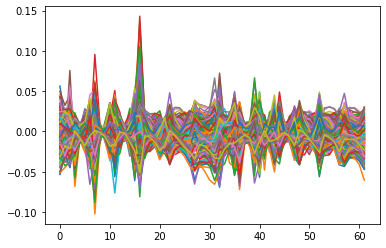

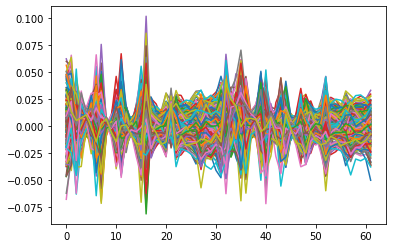

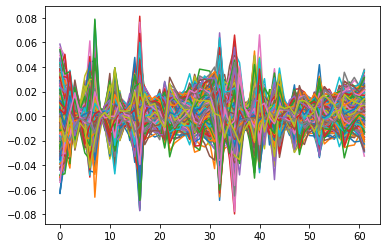

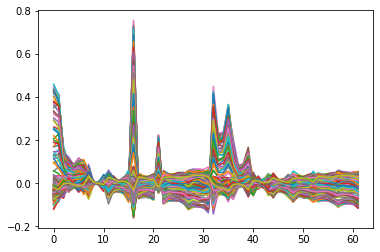

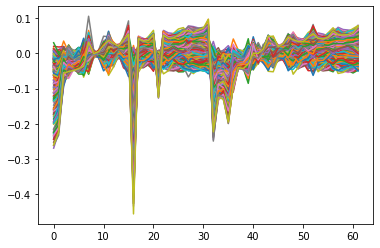

...

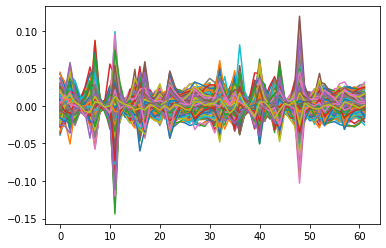

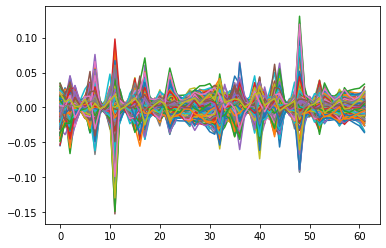

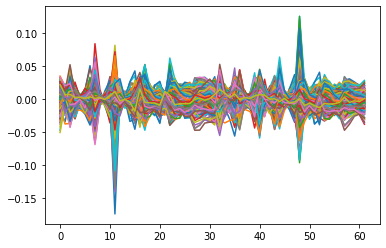

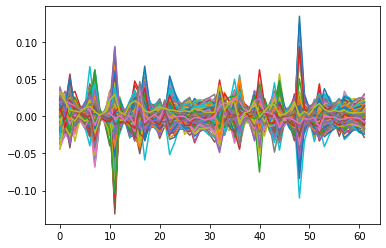

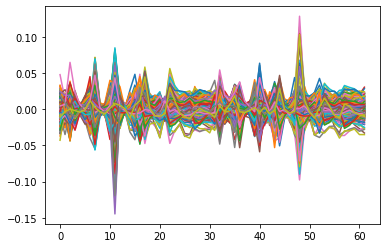

In [ ]:
import matplotlib.pyplot as plt
for i in range(0,101):
  plt.plot(x_label[i])
  plt.show()

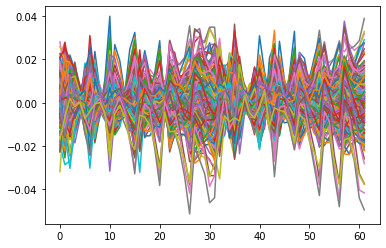

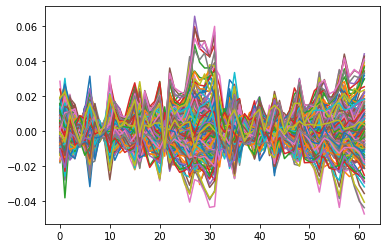

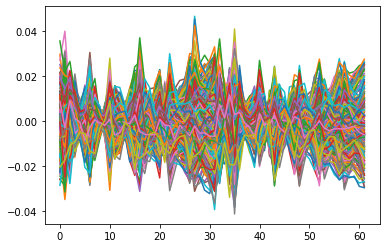

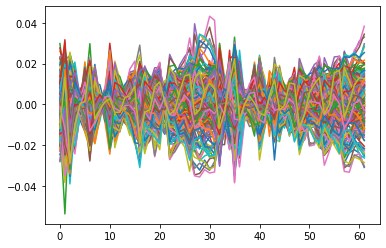

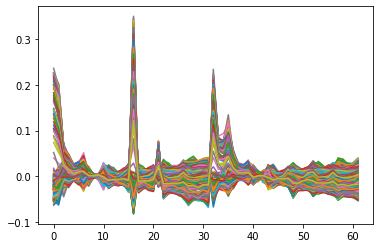

...

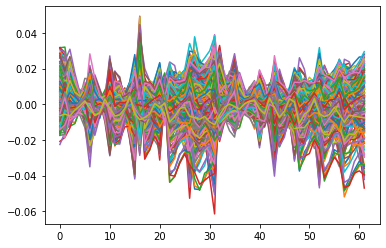

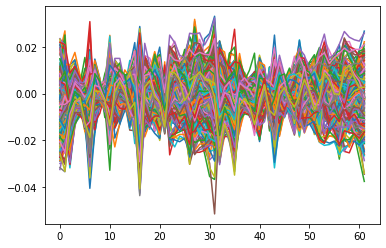

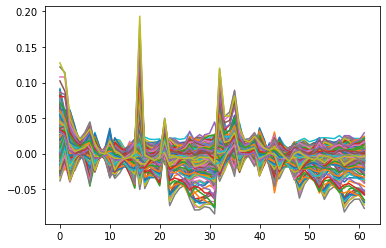

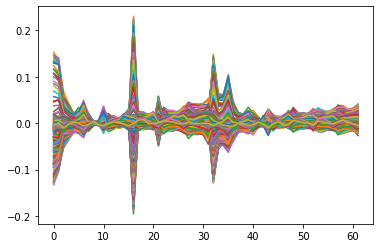

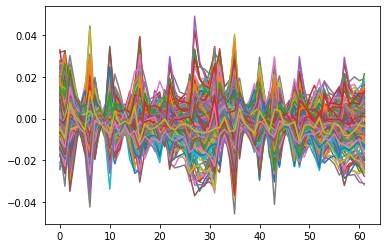

In [ ]:
import matplotlib.pyplot as plt
for i in range(2500,2601):
  plt.plot(x_label[i])
  plt.show()

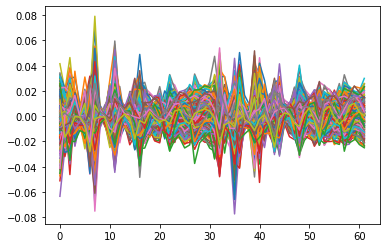

In [ ]:
plt.plot(x_train[20])
plt.show()

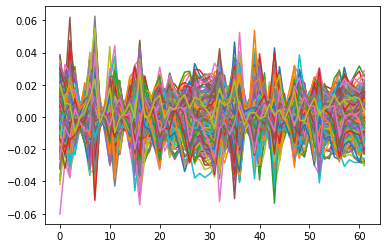

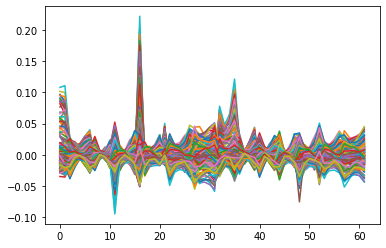

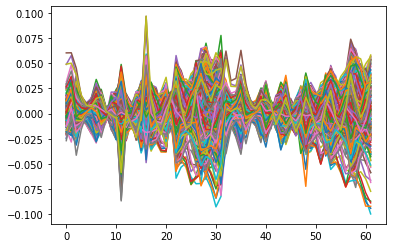

In [ ]:
plt.plot(x_train[69])
plt.show()
plt.plot(x_train[81])
plt.show()
plt.plot(x_train[15])
plt.show()

In [ ]:
# Importing Keras libraries and packages
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Convolution2D
from tensorflow.keras.layers import MaxPooling2D
from tensorflow.keras.layers import Flatten
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Dropout
from tensorflow.keras.layers import BatchNormalization

# Initializing the CNN
classifier = Sequential()

# Convolution Step 1
classifier.add(Convolution2D(96, 11, strides = (4, 4), padding = 'valid', input_shape=(512, 512, 1), activation = 'relu'))

# Max Pooling Step 1
classifier.add(MaxPooling2D(pool_size = (2, 2), strides = (2, 2), padding = 'valid'))
classifier.add(BatchNormalization())

# Convolution Step 2
classifier.add(Convolution2D(256, 11, strides = (1, 1), padding='valid', activation = 'relu'))

# Max Pooling Step 2
classifier.add(MaxPooling2D(pool_size = (2, 2), strides = (2, 2), padding='valid'))
classifier.add(BatchNormalization())

# Convolution Step 3
classifier.add(Convolution2D(384, 3, strides = (1, 1), padding='valid', activation = 'relu'))
classifier.add(BatchNormalization())

# Convolution Step 4
classifier.add(Convolution2D(384, 3, strides = (1, 1), padding='valid', activation = 'relu'))
classifier.add(BatchNormalization())

# Convolution Step 5
classifier.add(Convolution2D(256, 3, strides=(1,1), padding='valid', activation = 'relu'))

# Max Pooling Step 3
classifier.add(MaxPooling2D(pool_size = (2, 2), strides = (2, 2), padding = 'valid'))
classifier.add(BatchNormalization())

# Flattening Step
classifier.add(Flatten())

# Full Connection Step
classifier.add(Dense(units = 512, activation = 'relu'))
classifier.add(Dropout(0.2))
classifier.add(BatchNormalization())
classifier.add(Dense(units = 256, activation = 'relu'))
classifier.add(Dropout(0.1))
classifier.add(BatchNormalization())
classifier.add(Dense(units = 12, activation = 'relu'))
classifier.add(BatchNormalization())
classifier.add(Dense(units = 3, activation = 'softmax'))

classifier.summary()